In [1]:
# Imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random

import cv2
import glob
from skimage.metrics import structural_similarity as ssim
from sewar.full_ref import rmse, psnr, uqi

# Import helper functions from utils.py
import utils
import importlib
importlib.reload(utils)

# Save path
save_path = r"E:\SNU Chennai\projects\IVP\edge-detection-metrics\Evaluation metrics"

# Global variables
channels = ['Coastal \nAerosol','Blue','Green',
            'Red','Red Edge 1','Red Edge 2',
            'Red Edge 3','NIR','Red Edge 4',
            'Water \nVapour','SWIR 1','SWIR 2']

# Sobel thresholds (single-value gradient magnitude)
sobel_thresholds = [50, 100, 150, 200, 250, 300]

In [2]:
# Test image paths
test_path = glob.glob(r"E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\*")
print(test_path[0])
print(len(test_path))


E:\SNU Chennai\projects\IVP\edge-detection-metrics\SWED\SWED\test\images\S2A_MSIL2A_20190312T031541_N0211_R118_T48QYJ_20190312T083550_image_0_0.tif
98


In [3]:
# Initialise processor
processor = utils.data_processor()

In [4]:
# Load input data
def get_input(paths):
    input = []
    rgb = []
    labels = []

    for path in paths:
        try:
            img, rgb_img, label = processor.load_test(path)
            input.append(img)
            labels.append(label)
            rgb.append(rgb_img)
        except:
            print("Error with image: ", path)

    # Convert binary label to edge reference using Canny (as fixed ground truth edge)
    canny_input = [np.uint8(img * 255) for img in labels]
    edge_reference = [np.uint8(cv2.Canny(img, threshold1=100, threshold2=200)) for img in canny_input]

    return input, rgb, labels, edge_reference

input, rgb, labels, edge_reference = get_input(test_path)

c:\Users\sreen\anaconda3\envs\gdalpip\Lib\site-packages\osgeo\gdal.py:311: FutureWarning: Neither gdal.UseExceptions() nor gdal.DontUseExceptions() has been explicitly called. In GDAL 4.0, exceptions will be enabled by default.
  warnings.warn(


50


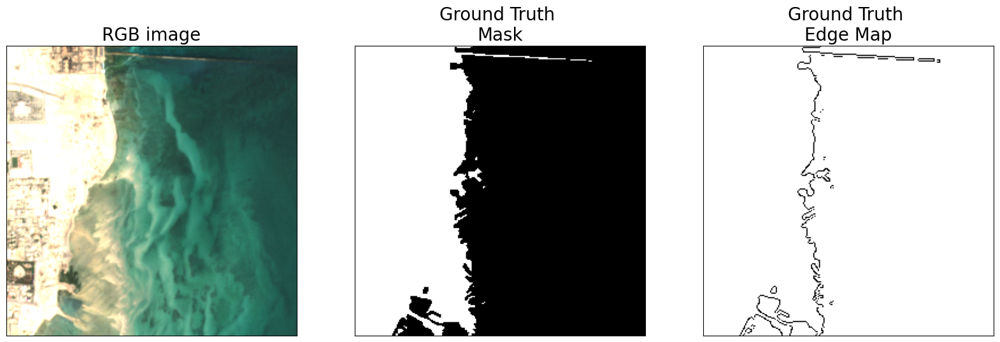

In [5]:
# Sense check
rint = np.random.randint(0, len(edge_reference))
print(rint)
fig, ax = plt.subplots(1, 3, figsize=(20, 20))
fig.set_facecolor('white')

ax[0].imshow(rgb[rint])
ax[0].set_title('RGB image', size=20)
ax[1].imshow(1 - labels[rint], cmap='gray')
ax[1].set_title('Ground Truth \nMask', size=20)
ax[2].imshow(255 - edge_reference[rint], cmap='gray')
ax[2].set_title('Ground Truth \nEdge Map', size=20)

for a in ax:
    a.set_xticks([])
    a.set_yticks([])

plt.savefig(save_path + '\\Figures\\sobel_dataset_example.png', dpi=300, bbox_inches='tight')


In [6]:
# Apply Sobel edge detection with thresholding
def get_sobel(input_images):
    sobel_input = input_images.copy()
    sobel = {}

    for thresh in sobel_thresholds:
        results = []
        for img in sobel_input:
            sobel_img = processor.preprocess(img)  # normalize per band
            out = np.zeros_like(sobel_img)
            for i in range(12):  # 12 bands
                band = sobel_img[:, :, i]
                sobel_band = processor.sobel_ed(band)
                # Apply post-magnitude threshold
                _, binary = cv2.threshold(sobel_band, thresh, 255, cv2.THRESH_BINARY)
                out[:, :, i] = binary
            results.append(out)
        sobel[str(thresh)] = results
        print(f"Threshold {thresh}: {len(results)} images processed.")
    return sobel

sobel = get_sobel(input)

Threshold 50: 98 images processed.
Threshold 100: 98 images processed.
Threshold 150: 98 images processed.
Threshold 200: 98 images processed.
Threshold 250: 98 images processed.
Threshold 300: 98 images processed.


In [7]:
# Evaluate Sobel output using metrics
rows = []

for threshold in sobel_thresholds:
    sobel_output = sobel[str(threshold)]

    for i, output in enumerate(sobel_output):
        ref_img = edge_reference[i]
        ID = i

        for j in range(len(channels)):
            img = output[:, :, j]

            # Evaluation metrics
            rmse_ = rmse(ref_img, img)
            psnr_ = psnr(ref_img, img)
            uqi_ = uqi(ref_img, img)
            ssim_ = ssim(ref_img, img, multichannel=True)
            fom_ = processor.fom(ref_img, img)
            tp_, fp_, tn_, fn_, tpr_, fpr_, tnr_, fnr_, fp_fn_ratio_ = processor.get_rates(ref_img, img)
            pde_ = np.count_nonzero(img) / np.count_nonzero(ref_img)

            row = [ID, threshold, j + 1, rmse_, psnr_, uqi_, ssim_, fom_,
                   tp_, fp_, tn_, fn_, tpr_, fpr_, tnr_, fnr_, fp_fn_ratio_, pde_]
            rows.append(row)

    print(f"Threshold {threshold} done")

# Save to CSV
df_metrics_sobel = pd.DataFrame(rows, columns=[
    'ID', "thresholds", "band", "rmse", "psnr", "uqi", "ssim", "fom",
    "tp", "fp", "tn", "fn", "tpr", "fpr", "tnr", "fnr", "fp_fn_ratio", "pde"
])

df_metrics_sobel.to_csv(save_path + "\\sobel_evaluation_metrics.csv")
df_metrics_sobel.head()

Threshold 50 done
Threshold 100 done
Threshold 150 done
Threshold 200 done
Threshold 250 done
Threshold 300 done


,ID,thresholds,band,rmse,psnr,uqi,ssim,fom,tp,fp,tn,fn,tpr,fpr,tnr,fnr,fp_fn_ratio,pde
0,0,50,1,81.782876,9.877556,0.602335,0.605672,0.482932,504,4815,58291,1926,0.207407,0.076300,0.923700,0.792593,2.500000,2.188889
1,0,50,2,81.982812,9.856347,0.639063,0.646740,0.498820,754,5098,58008,1676,0.310288,0.080785,0.919215,0.689712,3.041766,2.408230
2,0,50,3,83.565083,9.690307,0.650053,0.658329,0.491598,786,5394,57712,1644,0.323457,0.085475,0.914525,0.676543,3.281022,2.543210
3,0,50,4,93.282465,8.734803,0.624688,0.626157,0.493568,1127,7467,55639,1303,0.463786,0.118325,0.881675,0.536214,5.730622,3.536626
4,0,50,5,91.959470,8.858874,0.647549,0.654455,0.530543,1106,7199,55907,1324,0.455144,0.114078,0.885922,0.544856,5.437311,3.417695


### metric analysis

Threshold 50: 95 images processed.
Threshold 100: 95 images processed.
Threshold 150: 95 images processed.
Threshold 200: 95 images processed.
Threshold 250: 95 images processed.
Threshold 300: 95 images processed.


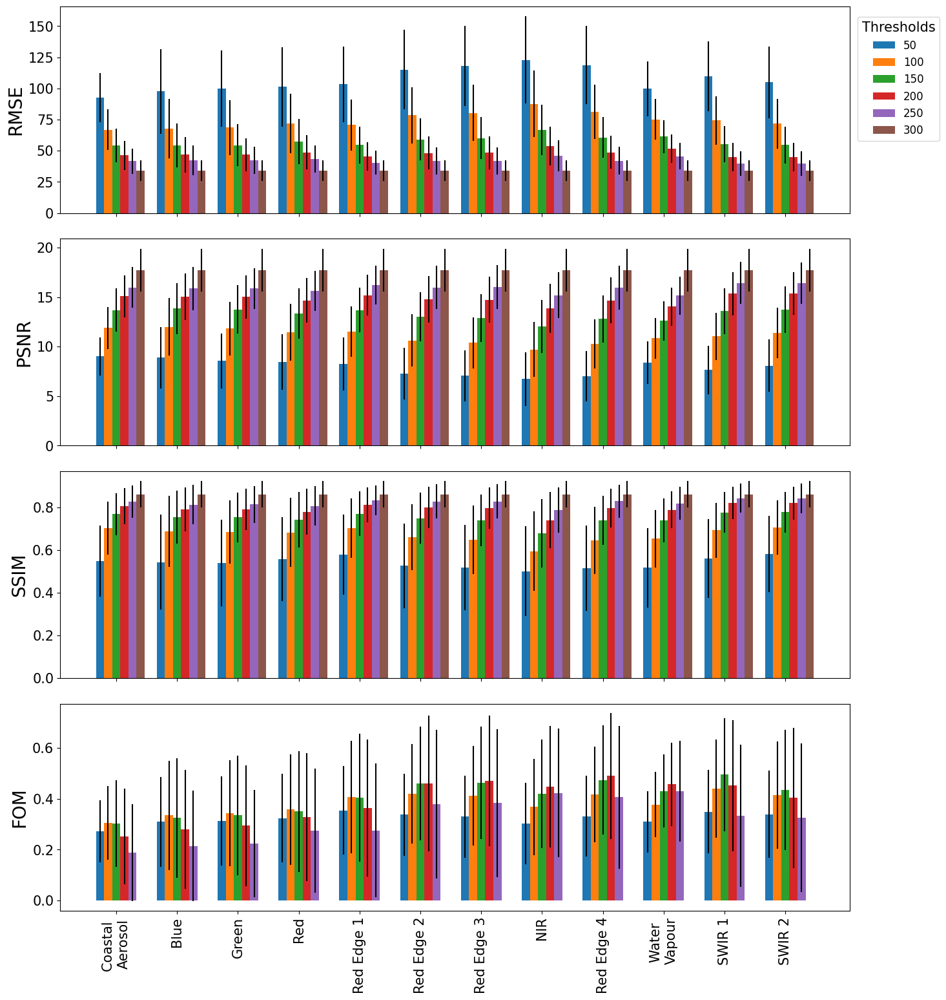

In [8]:
# Load and clean metrics
df_metrics_sobel = pd.read_csv(save_path + "\\sobel_evaluation_metrics.csv")
df_metrics_sobel['fp_fn'] = df_metrics_sobel['fp'] + df_metrics_sobel['fn']

# Drop mislabeled images
df_metrics_sobel_2 = df_metrics_sobel.copy()
df_metrics_sobel_2 = df_metrics_sobel_2.drop(df_metrics_sobel_2[df_metrics_sobel_2['ID'] == 18].index)
df_metrics_sobel_2 = df_metrics_sobel_2.drop(df_metrics_sobel_2[df_metrics_sobel_2['ID'] == 41].index)
df_metrics_sobel_2 = df_metrics_sobel_2.drop(df_metrics_sobel_2[df_metrics_sobel_2['ID'] == 66].index)

# 🔧 Fix: Ensure threshold column is string type
df_metrics_sobel_2['thresholds'] = df_metrics_sobel_2['thresholds'].astype(str)

# Fix thresholds list to string
sobel_thresholds_str = [str(t) for t in sobel_thresholds]

# Recompute inputs/outputs
test_paths_2 = test_path.copy()
path1 = test_paths_2.pop(18)
path2 = test_paths_2.pop(41 - 1)
path3 = test_paths_2.pop(66 - 2)

input_2, rgb_2, labels_2, edge_reference_2 = get_input(test_paths_2)
sobel_2 = get_sobel(input_2)

# Initialize visualizer and plot
viz_sobel = utils.data_visualizer(df_metrics_sobel_2, sobel_2, edge_reference_2, rgb_2, sobel_thresholds_str, channels)
viz_sobel.plot_combined_metric_trends(['rmse', 'psnr', 'ssim', 'fom'],
                                      save_path=save_path + "\\Figures\\sobel_all_metrics.png")


In [9]:
# --- Filter only NIR band (band 7) ---
df_metrics_sobel_nir = df_metrics_sobel_2[df_metrics_sobel_2['band'] == 7]

# --- Mean evaluation metrics per threshold ---
df_mean_sobel = df_metrics_sobel_nir[['thresholds', 'rmse', 'psnr', 'ssim', 'fom']].groupby('thresholds').mean().reset_index()
df_mean_sobel['Threshold'] = df_mean_sobel['thresholds'].astype(int)  # convert string to int for sorting

df_mean_sobel = df_mean_sobel.sort_values(by='Threshold')[['Threshold', 'rmse', 'psnr', 'ssim', 'fom']]
df_mean_sobel.columns = ['Threshold', 'RMSE', 'PSNR', 'SSIM', 'FOM']
df_mean_sobel = df_mean_sobel.round(2)

# --- Copy to clipboard (optional) ---
df_mean_sobel.to_clipboard(index=False)
df_mean_sobel.head()


,Threshold,RMSE,PSNR,SSIM,FOM
5,50,117.88,7.06,0.52,0.33
0,100,80.44,10.38,0.65,0.41
1,150,60.11,12.88,0.74,0.46
2,200,48.44,14.74,0.80,0.47
3,250,41.74,16.00,0.83,0.38


In [10]:
# --- Initialize count dataframe with threshold values ---
best_threshold_count_sobel = pd.DataFrame({'Threshold': sobel_thresholds})

for metric in ['rmse', 'psnr', 'ssim', 'fom']:
    df = df_metrics_sobel_2[['ID', 'thresholds', metric]]

    # Select best threshold per image
    if metric == 'rmse':
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmin()]
    else:
        best_thresholds = df.loc[df.groupby('ID')[metric].idxmax()]

    # Count occurrences of each threshold
    count = []
    print(f"\nBest thresholds for {metric.upper()}:")
    for threshold in sobel_thresholds:
        df_thresh = best_thresholds[best_thresholds['thresholds'] == str(threshold)]
        count.append(len(df_thresh))
        print(f"Threshold {threshold}: {len(df_thresh)} occurrences")

    best_threshold_count_sobel[metric.upper()] = count

# --- Copy to clipboard (optional) ---
best_threshold_count_sobel.to_clipboard(index=False)
best_threshold_count_sobel



Best thresholds for RMSE:
Threshold 50: 0 occurrences
Threshold 100: 0 occurrences
Threshold 150: 0 occurrences
Threshold 200: 1 occurrences
Threshold 250: 2 occurrences
Threshold 300: 92 occurrences

Best thresholds for PSNR:
Threshold 50: 0 occurrences
Threshold 100: 0 occurrences
Threshold 150: 0 occurrences
Threshold 200: 1 occurrences
Threshold 250: 2 occurrences
Threshold 300: 92 occurrences

Best thresholds for SSIM:
Threshold 50: 1 occurrences
Threshold 100: 2 occurrences
Threshold 150: 1 occurrences
Threshold 200: 5 occurrences
Threshold 250: 23 occurrences
Threshold 300: 63 occurrences

Best thresholds for FOM:
Threshold 50: 3 occurrences
Threshold 100: 6 occurrences
Threshold 150: 13 occurrences
Threshold 200: 28 occurrences
Threshold 250: 45 occurrences
Threshold 300: 0 occurrences


,Threshold,RMSE,PSNR,SSIM,FOM
0,50,0,0,1,3
1,100,0,0,2,6
2,150,0,0,1,13
3,200,1,1,5,28
4,250,2,2,23,45
5,300,92,92,63,0


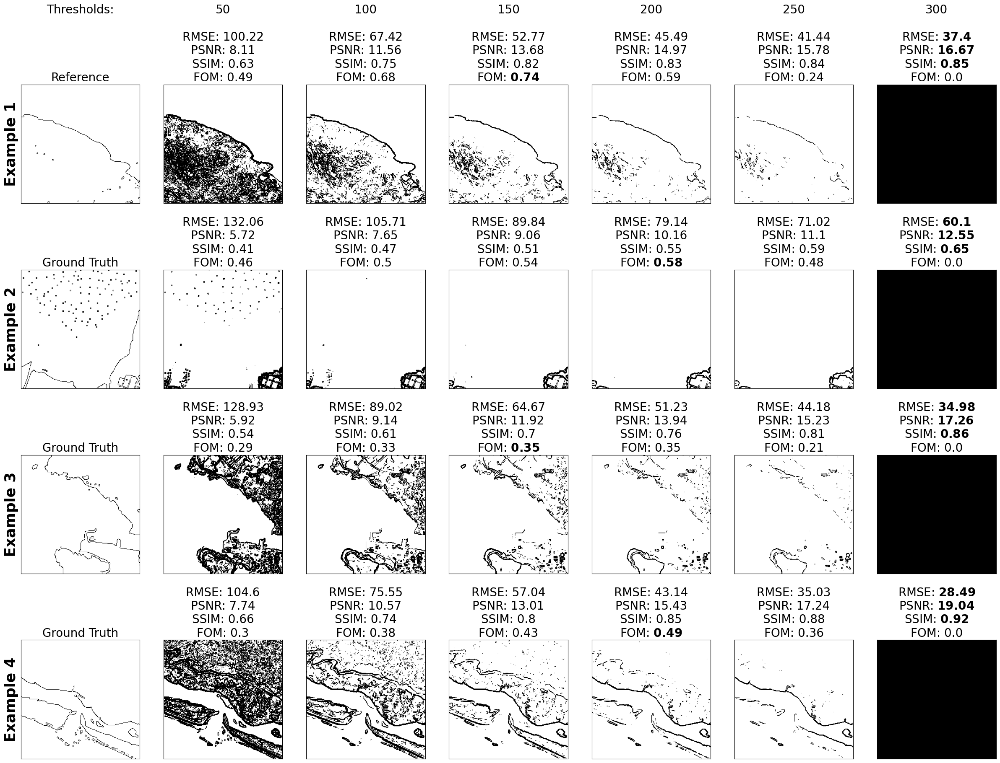

In [11]:
# --- Convert 'thresholds' column to string for matching ---
df_metrics_sobel_2["thresholds"] = df_metrics_sobel_2["thresholds"].astype(str)

# --- Select image IDs where FOM behaves meaningfully ---
IDs = [74, 40, 2, 68]

# --- Plot and save Sobel edge examples using the sobel visualizer ---
viz_sobel.example_plots(IDs, save_path=save_path + "\\Figures\\sobel_good_examples.png")


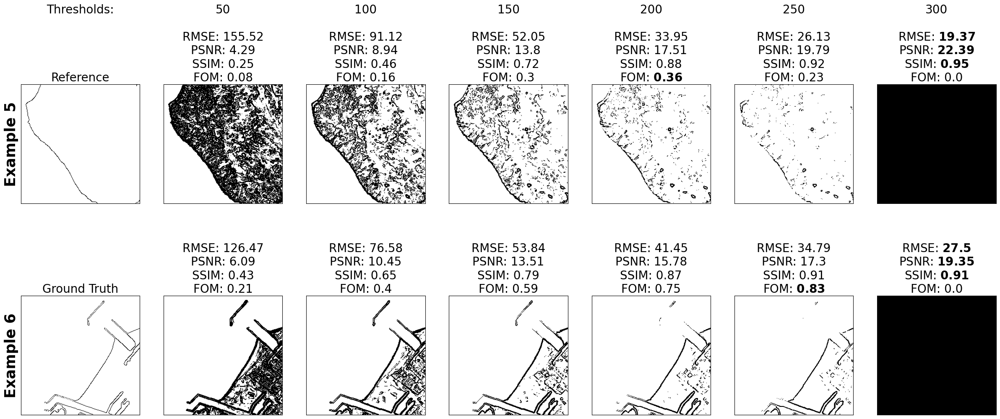

In [12]:
# Examples of results where FOM does not identify the best threshold
IDs = [15,32]
viz_sobel.example_plots(IDs,ex_diff=4,save_path=save_path+"\\Figures\\bad_examples.png")

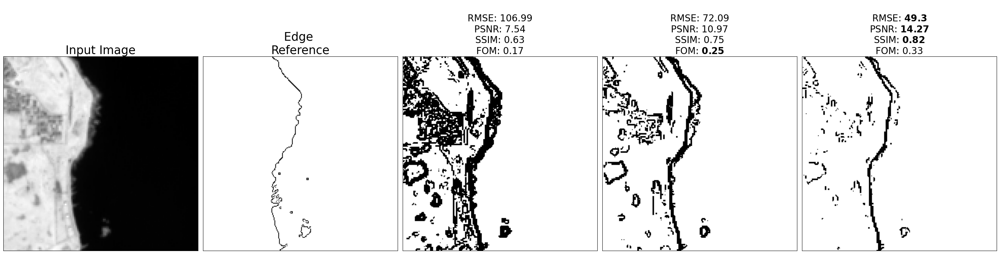

In [15]:
import importlib
importlib.reload(utils)  # Reload updated utils.py

fig, axs = plt.subplots(1, 5, figsize=(30, 20))
fig.set_facecolor('white')

rint = 67  # Image index
thresholds = [50, 100, 150]  # Sobel thresholds (single values)
band = 10

img_input = input[rint].copy()

# Plot original input band
axs[0].imshow(img_input[:, :, band], cmap="gray")
axs[0].set_title("Input Image", size=25)

# Plot ground truth edge reference
ref_img = edge_reference[rint]
axs[1].imshow(255 - ref_img, cmap="gray")
axs[1].set_title("Edge \nReference", size=25)

# Processor instance
processor = utils.data_processor()

# Preprocess band for Sobel
sobel_input = processor.preprocess(img_input)
band_img = sobel_input[:, :, band]

# Loop through Sobel thresholds
for i, t in enumerate(thresholds):
    sobel_band = processor.sobel_ed(band_img)
    _, binary_img = cv2.threshold(sobel_band, t, 255, cv2.THRESH_BINARY)

    axs[i + 2].imshow(255 - binary_img, cmap="gray")

    # Compute metrics
    rmse_ = round(rmse(ref_img, binary_img), 2)
    psnr_ = round(psnr(ref_img, binary_img), 2)
    ssim_ = round(ssim(ref_img, binary_img, multichannel=True), 2)
    fom_ = round(processor.fom(ref_img, binary_img), 2)

    # Dynamic metric title formatting (bold best if needed)
    if i == 0:
        axs[i + 2].set_title(f"\nRMSE: {rmse_}\nPSNR: {psnr_}\nSSIM: {ssim_}\nFOM: {fom_}", size=20)
    elif i == 1:
        axs[i + 2].set_title(f"\nRMSE: {rmse_}\nPSNR: {psnr_}\nSSIM: {ssim_}\nFOM: " + r"$\bf{" + str(fom_) + "}$", size=20)
    else:
        axs[i + 2].set_title(
            "\nRMSE: " + r"$\bf{" + str(rmse_) + "}$" +
            "\nPSNR: " + r"$\bf{" + str(psnr_) + "}$" +
            "\nSSIM: " + r"$\bf{" + str(ssim_) + "}$" +
            "\nFOM: " + str(fom_), size=20
        )

# Remove ticks
for ax in axs:
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.savefig(save_path + "\\Figures\\sobel_threshold_comparison.png", dpi=300)
plt.show()


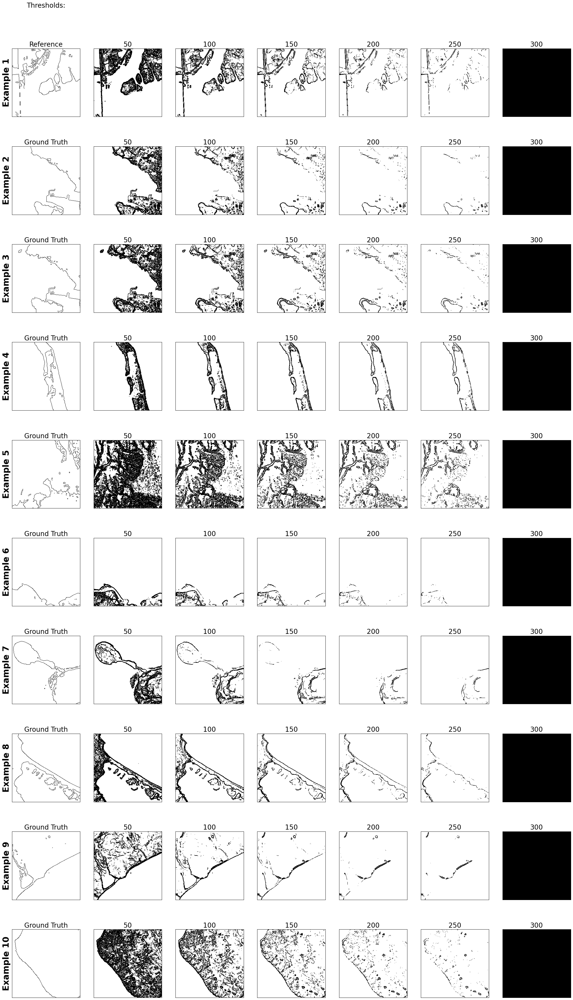

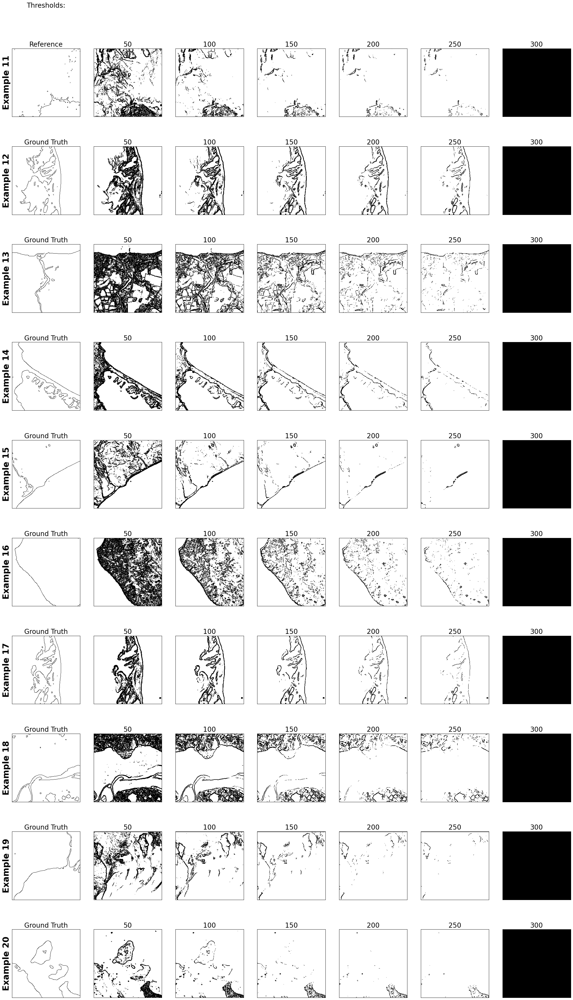

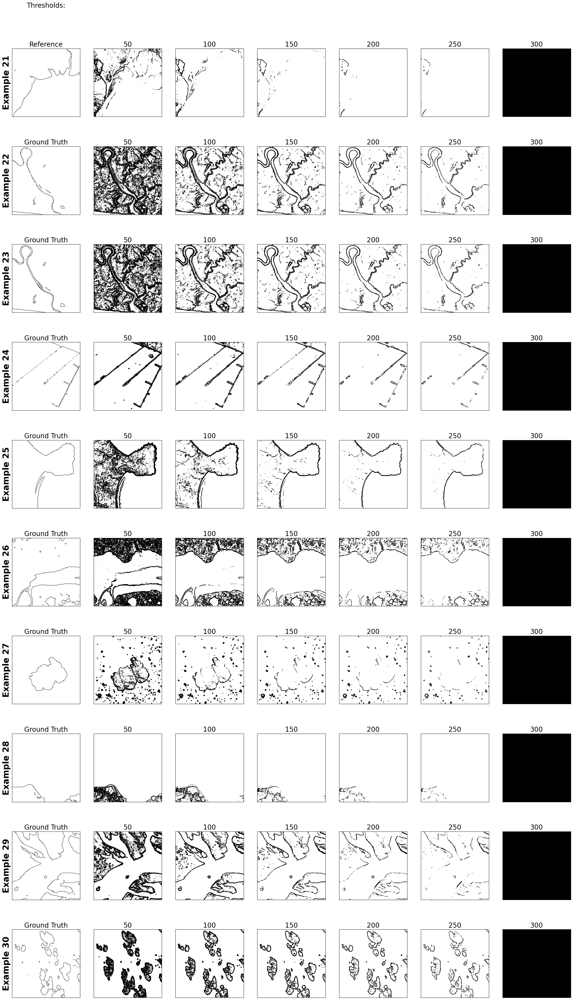

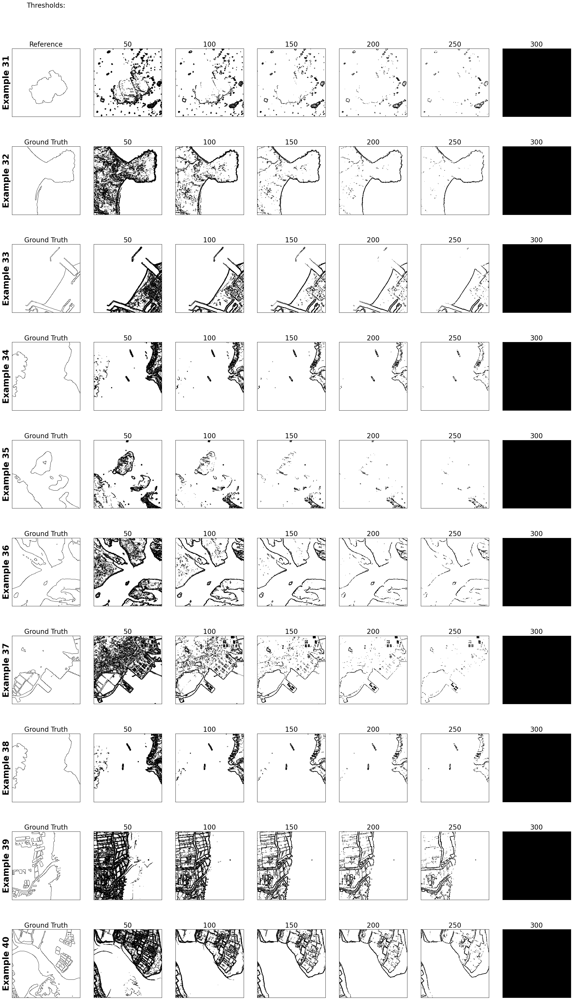

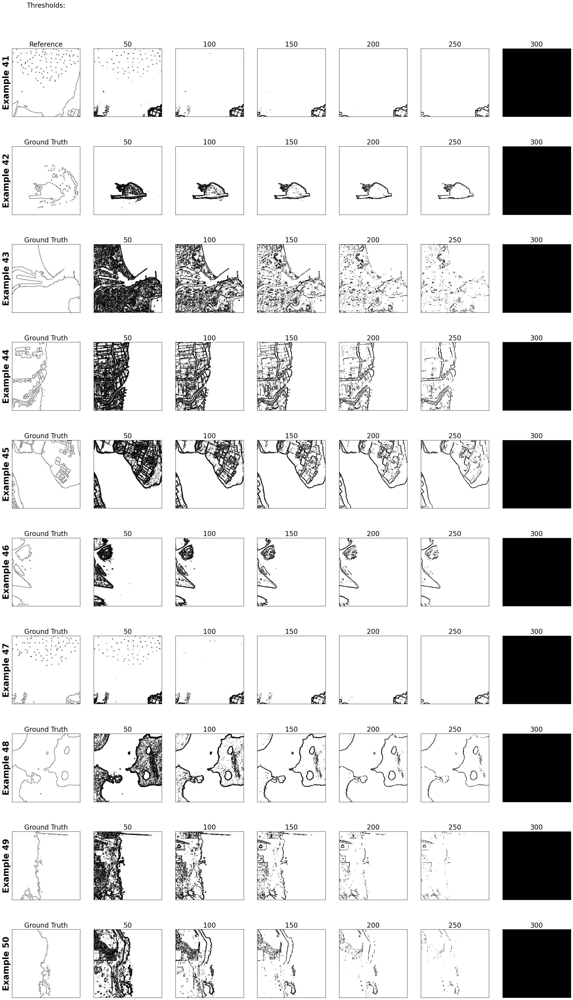

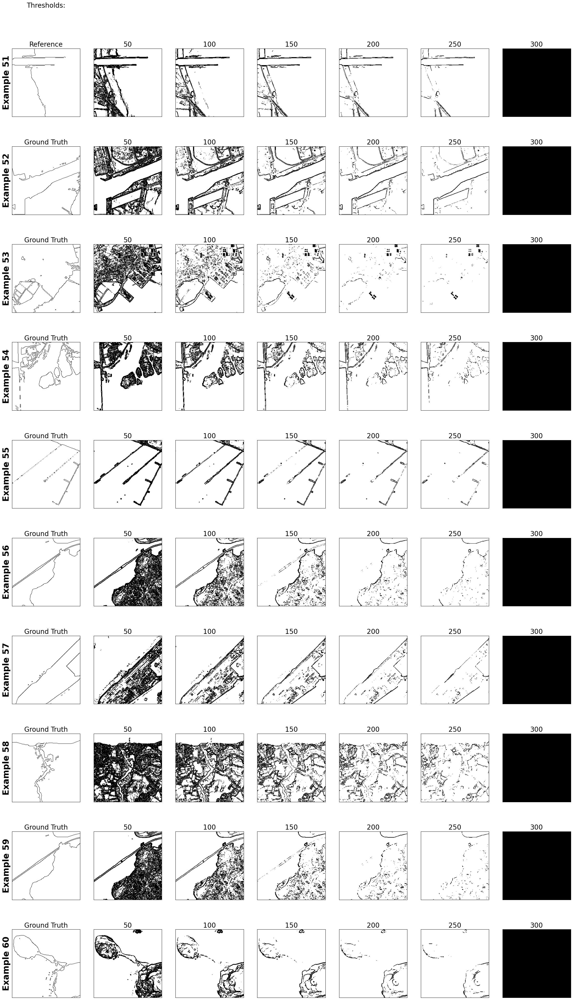

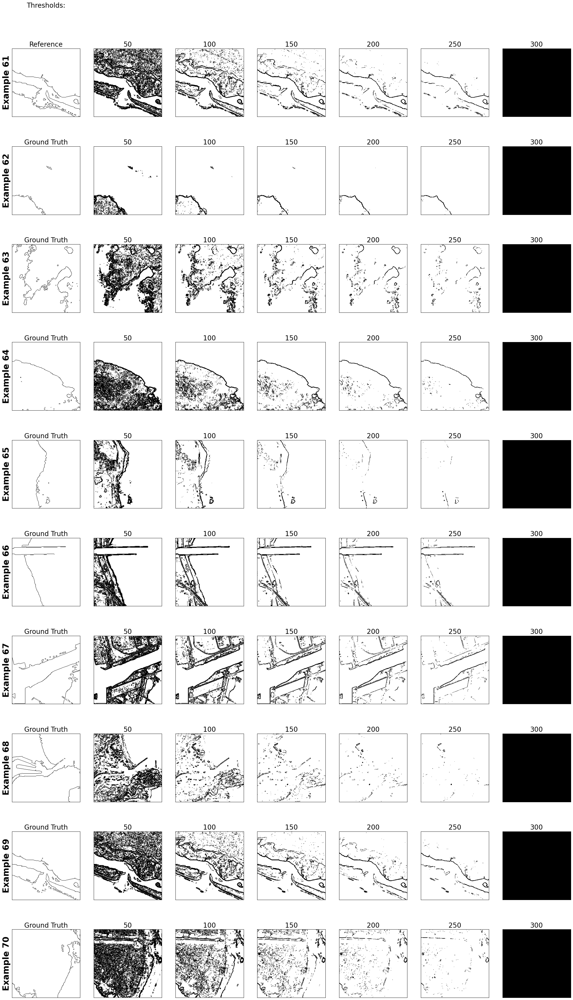

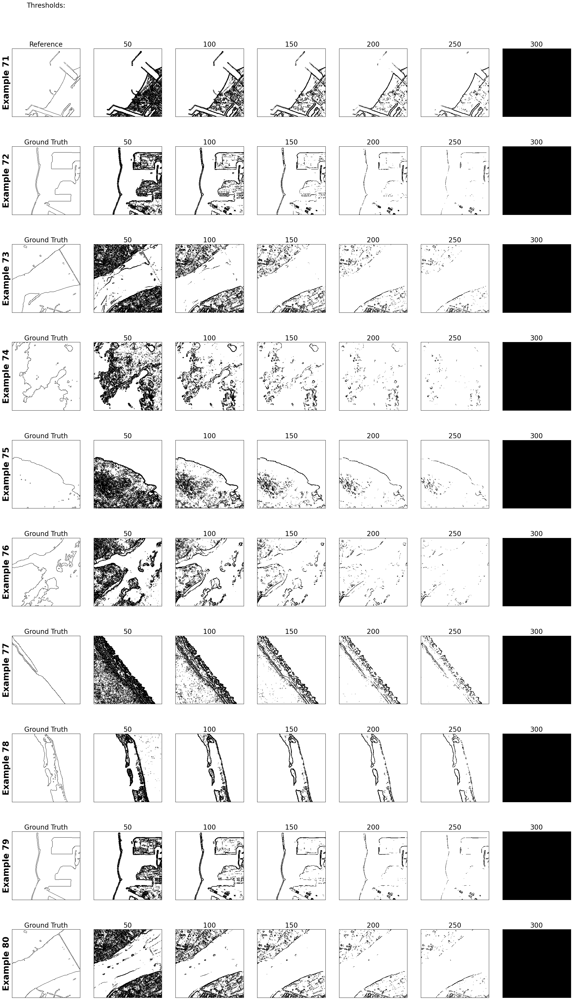

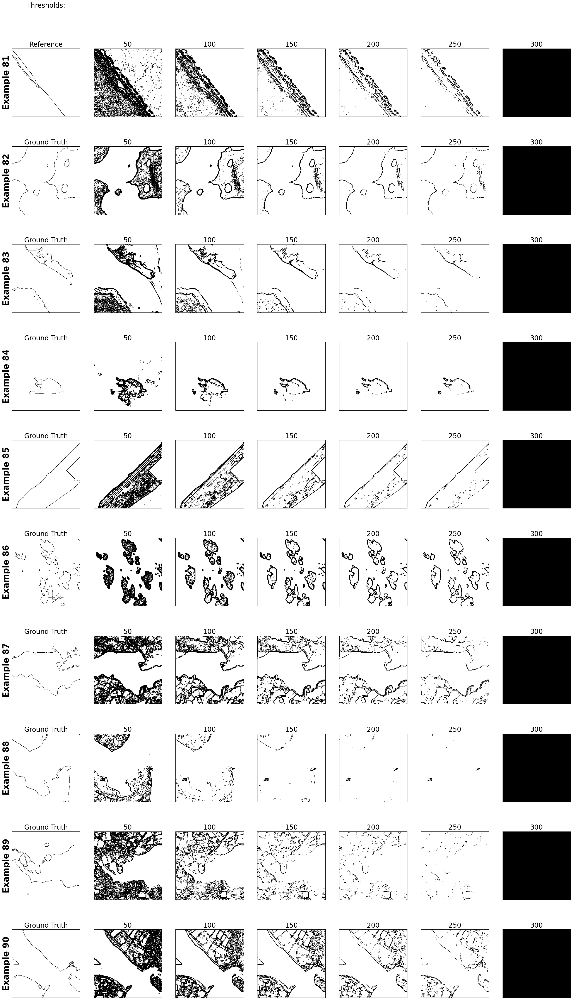

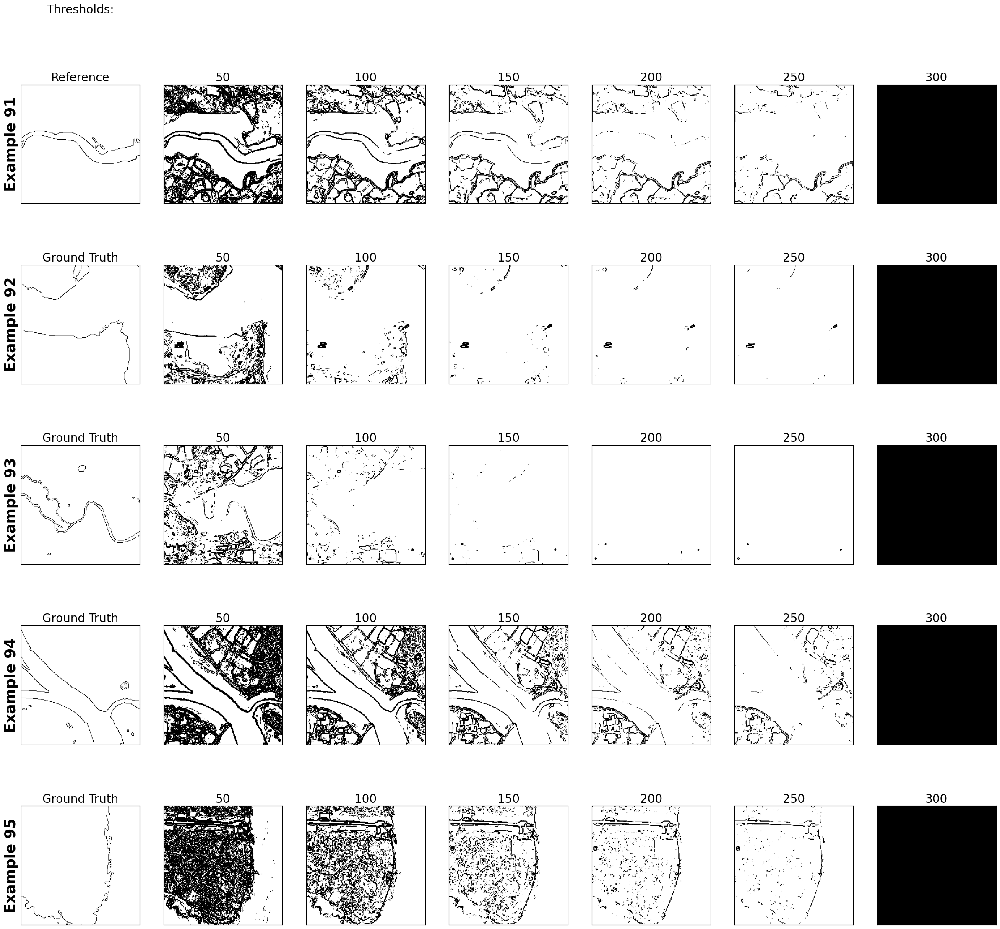

In [16]:
# --- Get image names from filtered test set (after removing bad ones) ---
x = [path.split("/")[-1] for path in test_paths_2]  # Use test_paths_2, not original test_path
df = pd.DataFrame({"ID": x})
df.to_clipboard(index=False)  # Copy image file names for manual inspection

# --- Group image IDs for visual inspection ---
ALL_IDS = [
    list(range(0, 10)), list(range(10, 20)), list(range(20, 30)),
    list(range(30, 40)), list(range(40, 50)), list(range(50, 60)),
    list(range(60, 70)), list(range(70, 80)), list(range(80, 90)),
    list(range(90, len(test_paths_2)))
]

# --- Generate Sobel example plots (no metrics) ---
for i, IDs in enumerate(ALL_IDS):
    viz_sobel.example_plots(IDs, ex_diff=10 * i, show_metrics=False,
                            save_path=save_path + f"\\Figures\\sobel_group_{i+1}.png")


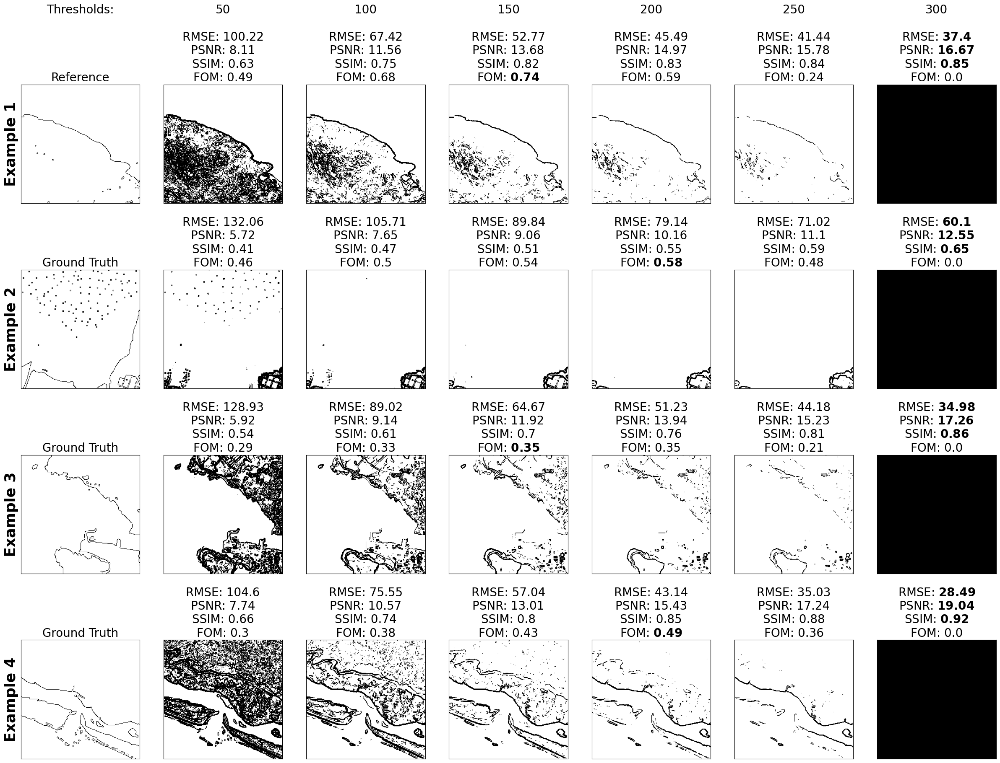

In [17]:
# --- Convert 'thresholds' column to string for matching ---
df_metrics_sobel_2["thresholds"] = df_metrics_sobel_2["thresholds"].astype(str)

# --- Select image IDs where FOM behaves meaningfully ---
IDs = [74, 40, 2, 68]

# --- Plot and save Sobel edge examples using the sobel visualizer ---
viz_sobel.example_plots(IDs, save_path=save_path + "\\Figures\\sobel_good_examples.png")
